In [2]:
from IPython.display import Audio
# Hear the audio
Audio('psd cover 2.wav')

sesudah di fillter bandpass

In [19]:
from IPython.display import Audio
# Hear the audio
Audio('kefilter.wav')

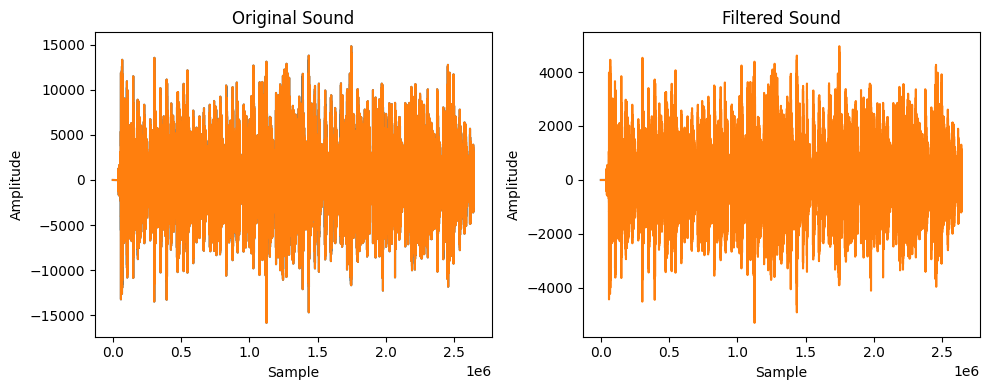

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.io.wavfile as wavfile
from scipy import signal

# Load the WAV file
try:
    sampling_rate, data = wavfile.read('psd cover 2.wav')
except FileNotFoundError:
    print("File not found.")
    exit()
except Exception as e:
    print("An error occurred while reading the file:", e)
    exit()

# Apply a noise reduction filter
# Here, we'll use a Butterworth bandpass filter
cutoff_low = 300  # Lower cutoff frequency (in Hz)
cutoff_high = 10000  # Upper cutoff frequency (in Hz)
order = 4  # Filter order

b, a = signal.butter(order, [cutoff_low, cutoff_high], fs=sampling_rate, btype='band')
filtered_data = signal.lfilter(b, a, data)

# Visualize the original sound
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.plot(data)
plt.title('Original Sound')
plt.xlabel('Sample')
plt.ylabel('Amplitude')

# Visualize the filtered sound
plt.subplot(1, 2, 2)
plt.plot(filtered_data)
plt.title('Filtered Sound')
plt.xlabel('Sample')
plt.ylabel('Amplitude')

# Save the filtered sound to a new WAV file
wavfile.write('Kefilter.wav', sampling_rate, filtered_data.astype(np.int16))

# Display the plots
plt.tight_layout()
plt.show()

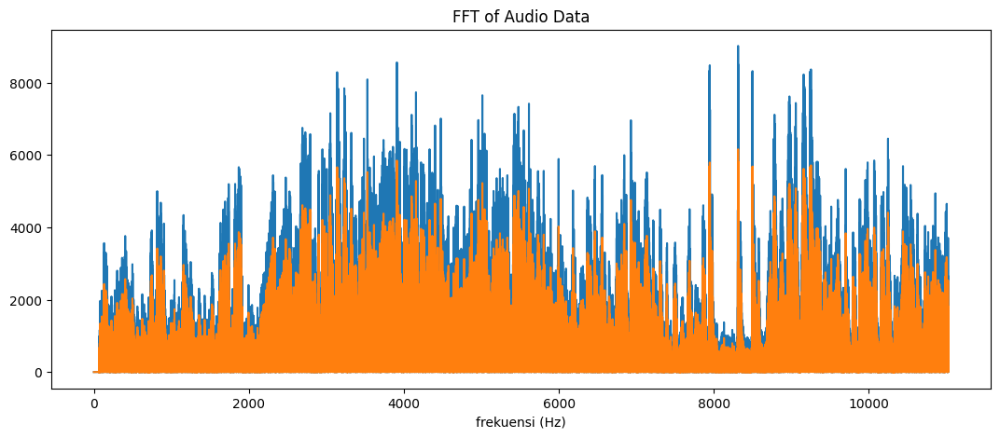

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.io.wavfile as wavfile
from scipy import signal
import librosa
import librosa.display
from scipy.fft import fft, fftfreq


data, sr = librosa.load('kefilter.wav')

def FFT(file, judul):
    X = fft(file)
    X_mag = np.absolute(X)
    f = np.linspace(0, sr, len(X_mag))
    plt.figure(figsize=(13, 5))
    plt.plot(f[:len(f)//2], X_mag[:len(f)//2])
    plt.xlabel("frekuensi (Hz)")
    plt.title(judul)


# memanggil file wav
try:
    sampling_rate, data = wavfile.read('kefilter.wav')
except FileNotFoundError:
    print("File not found.")
    exit()
except Exception as e:
    print("An error occurred while reading the file:", e)
    exit()

# mengHitung dan memplot FFT dari data audio
FFT(data, 'FFT of Audio Data')

# Display the plot
plt.show()

spectogram sebelum di fillter

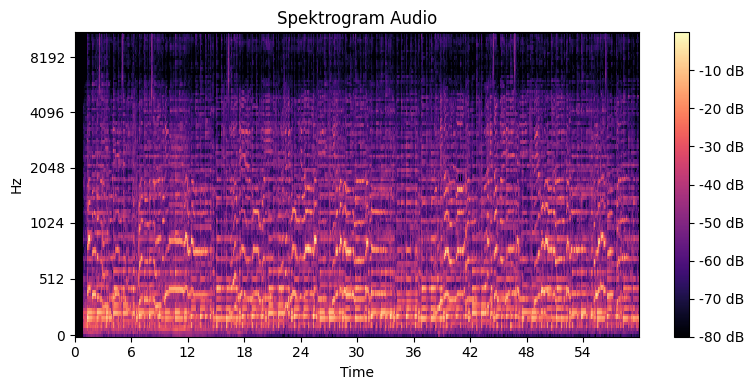

In [4]:
import os
import librosa
import librosa.display
import matplotlib.pyplot as plt

# Mendapatkan jalur lengkap ke file audio
audio_filename = 'psd cover 2.wav'
audio_path = os.path.join(os.getcwd(), audio_filename)

# Memuat file audio
audio_data, sr = librosa.load(audio_path)

# Menghitung spektrogram audio
spectrogram = librosa.feature.melspectrogram(y=audio_data, sr=sr)

# Mengkonversi amplitudo spektrogram ke skala logaritmik (dB)
spectrogram_db = librosa.power_to_db(spectrogram, ref=np.max)

# Menampilkan spektrogram
plt.figure(figsize=(8, 4))
librosa.display.specshow(spectrogram_db, sr=sr, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')
plt.title('Spektrogram Audio')
plt.tight_layout()
plt.show()

spectogram setelah di bandpass

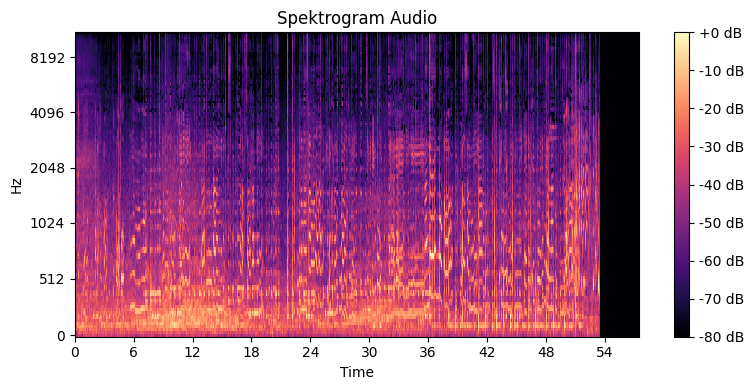

In [5]:
import os
import librosa
import librosa.display
import matplotlib.pyplot as plt

# Mendapatkan jalur lengkap ke file audio
audio_filename = 'kefilter.wav'
audio_path = os.path.join(os.getcwd(), audio_filename)

# Memuat file audio
audio_data, sr = librosa.load(audio_path)

# Menghitung spektrogram audio
spectrogram = librosa.feature.melspectrogram(y=audio_data, sr=sr)

# Mengkonversi amplitudo spektrogram ke skala logaritmik (dB)
spectrogram_db = librosa.power_to_db(spectrogram, ref=np.max)

# Menampilkan spektrogram
plt.figure(figsize=(8, 4))
librosa.display.specshow(spectrogram_db, sr=sr, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')
plt.title('Spektrogram Audio')
plt.tight_layout()
plt.show()